# I. Let import all useful packages.

In [1]:
from tensorflow import keras
import tensorflow.keras.layers as Layers
import tensorflow.keras.activations as Actications
import tensorflow.keras.models as Models
import tensorflow.keras.optimizers as Optimizer
import tensorflow.keras.metrics as Metrics
import tensorflow.keras.utils as Utils
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras.models import load_model
from tensorflow.keras.callbacks import TensorBoard
import tensorflow_addons as tfa
import os
import random
import datetime
import cv2
import numpy as np
from sklearn.utils import shuffle
from sklearn.metrics import confusion_matrix as CM
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plot
import seaborn as sn

c:\Users\thanh\AppData\Local\Programs\Python\Python310\lib\site-packages\tensorflow_addons\utils\ensure_tf_install.py:53: UserWarning: Tensorflow Addons supports using Python ops for all Tensorflow versions above or equal to 2.6.0 and strictly below 2.9.0 (nightly versions are not supported). 
 The versions of TensorFlow you are currently using is 2.9.1 and is not supported. 
Some things might work, some things might not.
If you were to encounter a bug, do not file an issue.
If you want to make sure you're using a tested and supported configuration, either change the TensorFlow version or the TensorFlow Addons's version. 
You can find the compatibility matrix in TensorFlow Addon's readme:
https://github.com/tensorflow/addons
  warnings.warn(


# II. Load the data.

## About dataset.
This is image data of Natural Scenes around the world.
This Data contains around 25k images of size 150x150 distributed under 6 categories. {'buildings' -> 0, 'forest' -> 1, 'glacier' -> 2, 'mountain' -> 3, 'sea' -> 4, 'street' -> 5 }


In [2]:
# Here's our 6 categories that we have to classify.
class_names = ['buildings', 'forest', 'glacier', 'mountain', 'sea', 'street']
class_names_label = {'buildings': 0,
                    'forest' : 1,
                    'glacier' : 2,
                    'mountain' : 3,
                    'sea' : 4,
                    'street' : 5
                    }
nb_classes = 6

## Loading the Data


In [5]:
def load_data(data_directories,image_size):
    """
        Load the data:
            - 14,034 images to train the network.
            - 3000 images to evaluate how accurately the network learned to classify images.
        Input:
            Data directory.
        Return: 
            training_set, testing_set.
    """
    ## TYPE YOUR CODE for task 4 here:
    path = 'image-classification/'
    directory_train = path + data_directories[0]
    directory_test  = path + data_directories[1]
    training_set = keras.preprocessing.image_dataset_from_directory(
            directory_train,
            labels="inferred",
            label_mode="int",
            class_names=None,
            image_size=image_size,
            shuffle=True,
            seed=8,
            validation_split=None,
            subset=None,
            follow_links=False,
            crop_to_aspect_ratio=False)
    testing_set = keras.preprocessing.image_dataset_from_directory(
            directory_test,
            labels="inferred",
            label_mode="int",
            class_names=None,
            image_size=image_size,
            shuffle=True,
            seed=8,
            validation_split=None,
            subset=None,
            follow_links=False,
            crop_to_aspect_ratio=False)   
     
    return training_set, testing_set



In [6]:
data_directories = ['seg_train/seg_train/', 'seg_test/seg_test/']
train_dataset, test_dataset = load_data(data_directories,(150,150))

Found 14034 files belonging to 6 classes.
Found 3000 files belonging to 6 classes.


In [7]:
#Get pred data
pred_path = 'image-classification/seg_pred/'
pred_set = keras.preprocessing.image_dataset_from_directory(
    pred_path,
    labels="inferred",
    label_mode="int",
    class_names=None,
    image_size=(150, 150),
    shuffle=True,
    seed=8,
    validation_split=None,
    subset=None,
    follow_links=False,
    crop_to_aspect_ratio=False)  


Found 7301 files belonging to 1 classes.


In [8]:
# Lấy dữ liệu từ dataset:
def get_data(dataset):
    data = []
    label = []
    for images, labels in dataset.unbatch():
        data.append(images.numpy()) 
        label.append(labels.numpy())
    data = np.array(data)
    label = np.array(label)

    return data,label


In [9]:
#Gán dữ liệu cho biến
train_data,train_label = get_data(train_dataset)
test_data,test_label = get_data(test_dataset)

## KHÁM PHÁ DỮ LIỆU


In [12]:
#Kích thước tập train,test và kích thước ảnh
print('Số ảnh train: '+ str(train_data.shape[0]))
print('Số ảnh test: '+ str(test_data.shape[0]))
print('Size of each image: '+ str(test_data.shape[1:4]))

Số ảnh train: 14034
Số ảnh test: 3000
Size of each image: (150, 150, 3)


### Trực quan hóa dữ liệu

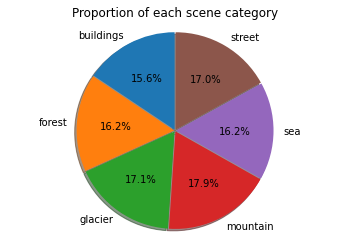

In [13]:
import pandas as pd
import matplotlib.pyplot as plt
def plot_pie(train_label, class_names):
    ## TYPE YOUR CODE for task 6 here:
    a = pd.DataFrame(train_label)
    count = a[0].value_counts().sort_index(ascending=True).to_list()
    fig1,ax1 = plt.subplots()
    ax1.pie(count,explode=(0.01,0.01,0.01,0.01,0.01,0.01),labels = class_names,autopct='%1.1f%%',startangle=90,shadow=True)
    plt.title('Proportion of each scene category')
    ax1.axis('equal')
    plt.show()

plot_pie(train_label, class_names)

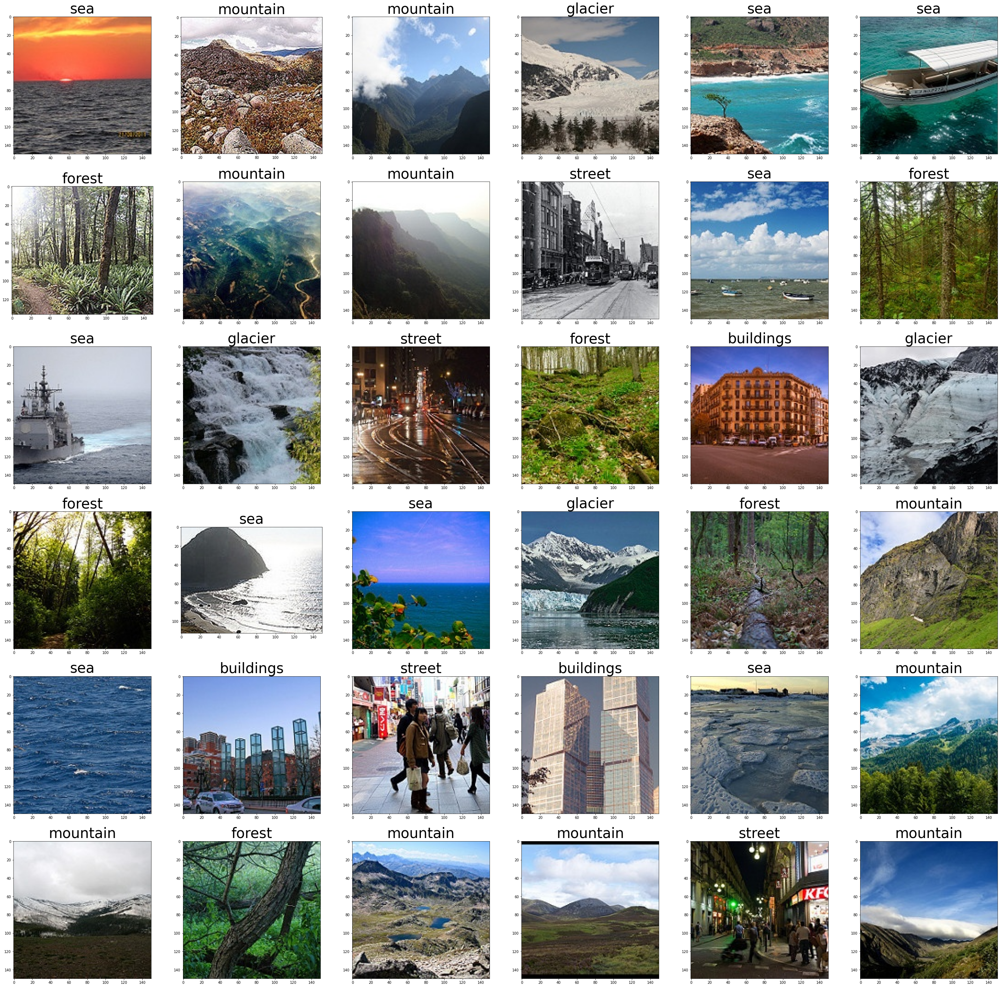

In [10]:
def visualize_image(train_directory):

    ## TYPE YOUR CODE for task 7 here:
    import cv2
    import os
    path = 'image-classification/'+train_directory
    images = os.listdir(path)
    img_data=[]
    label = []
    for img in images:
        path_1 = os.path.join(path,img)
        path_2 = os.listdir(path_1)
        for i in path_2:
            img_data.append(path_1+'/'+i)
            label.append(img)
    random_number = np.random.randint(1,len(img_data),36).tolist()
    count=1
    plt.figure(figsize=(50,50))
    for i in range(0,36):
        plt.subplot(6,6,count)
        plt.imshow(plt.imread(img_data[random_number[count-1]]))
        plt.title(label[random_number[count-1]],fontsize=40)
        count+=1
    plt.show()
train_directory = 'seg_train/seg_train/'
visualize_image(train_directory)

# III. MÔ HÌNH HÓA


In [23]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Flatten,Conv2D,MaxPooling2D,Dropout,BatchNormalization
from tensorflow.keras.initializers import RandomNormal, Constant
def create_model():
    '''
    Return: 
        CNN model with 13 layers.
    '''
    
    model = Models.Sequential()  
    model.add(Conv2D(filters = 8, kernel_size = (3,3),padding='Same',activation='relu',input_shape=(150,150,3))) #Layer 1
    model.add(Conv2D(filters = 16, kernel_size = (3,3),padding='Same',activation='relu')) #Layer 2 
    model.add(MaxPooling2D(pool_size = (2,2),strides=(2,2))) #Layer 3
    model.add(Conv2D(filters = 32, kernel_size = (3,3),padding='Same',activation='relu')) #Layer 4
    model.add(Conv2D(filters = 64, kernel_size = (3,3),padding='Same',activation='relu')) #Layer 5
    model.add(MaxPooling2D(pool_size = (3,3))) #Layer 6
    model.add(Conv2D(filters = 128, kernel_size = (3,3),padding='Same',activation='relu')) #Layer 7
    model.add(Conv2D(filters = 256, kernel_size = (3,3),padding='Same',activation='relu')) #Layer 8
    model.add(MaxPooling2D(pool_size = (5,5))) #Layer 9
    model.add(Flatten()) #Layer 10
    model.add(Dense(100,activation='relu')) #Layer 11
    model.add(Dropout(0.5)) #Layer 12
    model.add(Dense(6,activation= 'softmax')) #Layer 13
    ## TYPE YOUR CODE for task 8 here:

    return model
model = create_model()

## Compile

In [24]:
def optimize(model):
    '''
    Input: 
        Model.
    Return: 
        Complied model.
    '''
    ## TYPE YOUR CODE for task 9 here:
    #model.compile(optimizer=Optimizer.Adam(lr=0.0001),loss='categorical_crossentropy',metrics=['accuracy'])
    model.compile(optimizer=Optimizer.Adam(lr=0.0001),
                  loss = 'sparse_categorical_crossentropy',
                  metrics = ['accuracy'])
    return model

model = optimize(model)
print(model.summary())

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_18 (Conv2D)          (None, 150, 150, 8)       224       
                                                                 
 conv2d_19 (Conv2D)          (None, 150, 150, 16)      1168      
                                                                 
 max_pooling2d_9 (MaxPooling  (None, 75, 75, 16)       0         
 2D)                                                             
                                                                 
 conv2d_20 (Conv2D)          (None, 75, 75, 32)        4640      
                                                                 
 conv2d_21 (Conv2D)          (None, 75, 75, 64)        18496     
                                                                 
 max_pooling2d_10 (MaxPoolin  (None, 25, 25, 64)       0         
 g2D)                                                 

c:\Users\thanh\AppData\Local\Programs\Python\Python310\lib\site-packages\keras\optimizers\optimizer_v2\adam.py:110: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(Adam, self).__init__(name, **kwargs)


## Setup Callback

In [25]:
def callback_model(checkpoint_name, logs_name):
    '''
    Input: 
        Best checkpoint name, logs name.
    Return: 
        Callback list, which contains tensorboard callback and checkpoint callback.
    '''
    ## TYPE YOUR CODE for task 10 here:
    callbacks_list = [checkpoint_name,logs_name]
    print('Check point name: ',checkpoint_name)
    print('The best weights.best.hdf5: ',logs_name)
    return callbacks_list

checkpoint_name = 'weights.best.hdf5'
logs_name = 'training_logs'
callbacks_list = callback_model(checkpoint_name, logs_name)

Check point name:  weights.best.hdf5
The best weights.best.hdf5:  training_logs


## Train Model

In [26]:
import tensorflow as tf
def train_model(model, callbacks_list):
    '''
    Input: 
        Model and callback list,
    Return: 
        Model with best-checkpoint weights.
    '''
    ## TYPE YOUR CODE for task 11 here:
    logdir = os.path.join("logs", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
    tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)
    filepath = callbacks_list[0]
    checkpoint = ModelCheckpoint(filepath, monitor='val_accuracy', verbose=1, save_best_only=True, mode='max')
    model.fit(train_dataset, 
              epochs = 10, 
              validation_data=(test_dataset),
              
              callbacks = [tensorboard_callback,checkpoint]
              )
    return model
model = train_model(model, callbacks_list)


Epoch 1/10
439/439 [==============================] - ETA: 0s - loss: 1.6367 - accuracy: 0.3901
Epoch 1: val_accuracy improved from -inf to 0.57733, saving model to weights.best.hdf5
439/439 [==============================] - 183s 417ms/step - loss: 1.6367 - accuracy: 0.3901 - val_loss: 1.2273 - val_accuracy: 0.5773
Epoch 2/10
439/439 [==============================] - ETA: 0s - loss: 1.2506 - accuracy: 0.5004
Epoch 2: val_accuracy improved from 0.57733 to 0.67433, saving model to weights.best.hdf5
439/439 [==============================] - 186s 423ms/step - loss: 1.2506 - accuracy: 0.5004 - val_loss: 0.9422 - val_accuracy: 0.6743
Epoch 3/10
439/439 [==============================] - ETA: 0s - loss: 1.0677 - accuracy: 0.5832
Epoch 3: val_accuracy improved from 0.67433 to 0.71100, saving model to weights.best.hdf5
439/439 [==============================] - 174s 397ms/step - loss: 1.0677 - accuracy: 0.5832 - val_loss: 0.7830 - val_accuracy: 0.7110
Epoch 4/10
439/439 [====================

#Load model 

In [21]:
#Load model có sẵn
import h5py
import numpy as np
file_name = 'weights.best.hdf5'
import tensorflow as tf
model = tf.keras.models.load_model(file_name,custom_objects= None, compile=True,options=None)

## Show TensorBoard

In [15]:
## TYPE YOUR CODE for task 12 here:
#!kill 685
%tensorboard --logdir logs


UsageError: Line magic function `%tensorboard` not found.


## Predict and Evaluate

In [27]:
import sklearn.metrics
def get_prediction_classes(model, prediction_dataset):
    ## TYPE YOUR CODE for task 13 here:
    '''
    Input: 
        Model and prediction dataset.
    Return: 
        Prediction list and groundtrurth list with predicted classes.
    '''
    softmax_predict = model.predict(prediction_dataset)
    prediction_list = np.argmax(softmax_predict,axis=-1) 
    f1 = sklearn.metrics.f1_score(test_label,prediction_list,average='macro')
    print('Giá trị F1-Score = %.2f'%f1)
    return prediction_list

predictions = get_prediction_classes(model,test_data)

94/94 [==============================] - 7s 79ms/step
Giá trị F1-Score = 0.83


## Show Confusion Matrix

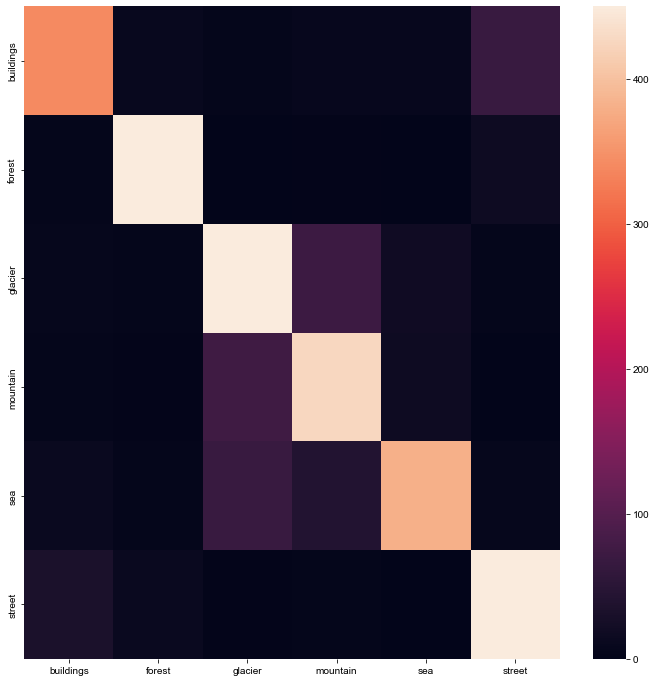

In [28]:
import seaborn as sns
def plot_confusion_matrix(predictions, groundtruth, class_names):
    ## TYPE YOUR CODE for task 14 here:
    res = tf.math.confusion_matrix(groundtruth,predictions)
    plt.figure(figsize=(12,12))
    sns.heatmap(res,xticklabels=class_names,yticklabels=class_names)
    sns.set(font_scale=4)  
    plot.show()
plot_confusion_matrix(predictions, test_label, class_names)